In [43]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import torch
import torch.nn as nn
import torch.optim as optim

# Set Random Seed for reproducibility
# seed = 42
# torch.manual_seed(seed)
# np.random.seed(seed)
# random.seed(seed)

# use cuda if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

max_time = 4


# def generalized_logistic(x, A, K, B, Q, M, nu):

#     x = x.view(-1)
#     A = A.view(-1)
#     K = K.view(-1)
#     B = B.view(-1)
#     Q = Q.view(-1)
#     M = M.view(-1)
#     nu = nu.view(-1)
#     # M = 0
#     # A = 0
#     # nu = 1
#     # Q=1
#     """
#     Generalized logistic function with A (lower asymptote), K (upper asymptote),
#     B (growth rate), Q (steepness), M (midpoint), and nu (sharpness).
#     Returns the evaluated function at x.
#     """
#     return A + (K - A) / (1 + Q * torch.exp(-B * (x - M))) ** (1 / (nu))

def process_velocities(wheel_data):
    return np.abs(wheel_data - np.min(wheel_data))

# Directory containing the processed data folders
input_directory = "../../../trajectory_data/real/recordings/x"

# Collect all CSV file paths from "wheel_velocities" folders
csv_files = []
for root, dirs, files in os.walk(input_directory):
    for dir_name in dirs:
        if dir_name == "wheel_velocities" and "complex_random_trajectory" not in root:
            folder_path = os.path.join(root, dir_name)
            for filename in os.listdir(folder_path):
                if filename.endswith(".csv"):# and not "-" in filename:
                    csv_files.append(os.path.join(folder_path, filename))

# Shuffle and split the CSV files into training and validation sets
random.shuffle(csv_files)
split_index = int(len(csv_files) * 0.7)
training_files = csv_files[:split_index]
validation_files = csv_files[split_index:]

# Function to collect data from given CSV files
def collect_data(files):
    times = []
    values = []
    target_velocities = []
    
    for file_path in files:
        data = pd.read_csv(file_path)
        time = data['Time']
        wheels = data.columns[1:]
        
        for wheel in wheels:
            values_array = process_velocities(data[wheel])

            adjusted_time = time - time.iloc[0]
            adjusted_time = adjusted_time[adjusted_time < max_time]
            values_array = values_array[: len(adjusted_time)]

            sorted_values = values_array.sort_values().reset_index(drop=True)
            index_95th = int(len(sorted_values) * 0.95)
            lower_index = max(0, index_95th - 5)
            upper_index = min(len(sorted_values) - 1, index_95th + 5)
            neighbors = sorted_values[lower_index:upper_index + 1]
            target_velocity = neighbors.mean()
            
            times.extend(adjusted_time)
            values.extend(values_array)
            target_velocities.extend([target_velocity] * len(values_array))
                    
    return np.array(times), np.array(values), np.array(target_velocities)

# Collect data from training and validation files
train_times, train_values, train_medians = collect_data(training_files)
val_times, val_values, val_medians = collect_data(validation_files)

print("Training data size:", len(train_times))

def gompertz(x, L=1, k=6, x0=0.1):
    x = x.view(-1)
    L = L.view(-1)
    k = k.view(-1)
    x0 = x0.view(-1)

    return L * torch.exp(-torch.exp(-k * (x - x0)))

# class S_Curve_net(nn.Module):
#     def __init__(self):
#         super(S_Curve_net, self).__init__()

#         self.fc1 = nn.Linear(1, 35)  W
#         self.fc2 = nn.Linear(35, 15)
#         self.fc3 = nn.Linear(15, 2)  

#         # Weight Initialization
#         self._initialize_weights()

#     def _initialize_weights(self):
#         for m in self.modules():
#             if isinstance(m, nn.Linear):
#                 nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
#                 if m.bias is not None:
#                     nn.init.constant_(m.bias, 0)

#     def forward(self, x, K):
#         # Normalize both x and K using the custom normalization layer
#         K = K.view(-1, 1)
#         x = x.view(-1, 1)

#         # Pass normalized K through the fully connected layers
#         out = torch.relu(self.fc1(K))
#         out = torch.relu(self.fc2(out))
#         out = self.fc3(out)

#         # # Clamp outputs to prevent instability
#         # A = torch.clamp(out[:, 0], min=0.0)             
#         # B = torch.clamp(out[:, 1], min=0.5)  
#         # Q = torch.clamp(out[:, 2], min=0.5)  
#         # M = torch.clamp(out[:, 3], min=0.0)   
#         # nu = torch.clamp(out[:, 4], min=0.5) 

#         # Pass normalized x and the predicted parameters to generalized logistic function
#         # out = generalized_logistic(x=x, A=A, K=K, B=B, Q=Q, M=M, nu=nu)
#         out = gompertz(x=x, L=K, k=out[:,0], x0=out[:,1])
#         return out
class S_Curve_net(nn.Module):
    def __init__(self):
        super(S_Curve_net, self).__init__()

        # Reintroduce hidden layers for nonlinear regression
        self.fc1 = nn.Linear(1, 100)  
        self.fc2 = nn.Linear(100, 50)
        self.fc3 = nn.Linear(50, 2)  

        # Weight Initialization
        self._initialize_weights()

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_uniform_(m.weight, nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, x, K):
        K = K.view(-1, 1)
        x = x.view(-1, 1)

        # Pass K through the fully connected layers with ReLU activations
        out = torch.relu(self.fc1(K))
        out = torch.relu(self.fc2(out))
        out = self.fc3(out)

        # Optionally, apply activation functions to the outputs to ensure they are in reasonable ranges
        k = torch.relu(out[:, 0]) + 0.01  # Ensure k is positive
        x0 = out[:, 1]  # x0 can be positive or negative depending on the data

        # Compute the Gompertz function with the predicted parameters
        out = gompertz(x=x, L=K, k=k, x0=x0)
        return out



# Prepare data for PyTorch
train_times_tensor = torch.tensor(train_times, dtype=torch.float32)
train_values_tensor = torch.tensor(train_values, dtype=torch.float32)
train_medians_tensor = torch.tensor(train_medians, dtype=torch.float32)

val_times_tensor = torch.tensor(val_times, dtype=torch.float32)
val_values_tensor = torch.tensor(val_values, dtype=torch.float32)
val_medians_tensor = torch.tensor(val_medians, dtype=torch.float32)

# Train on all data
train_times_tensor = torch.cat((train_times_tensor, val_times_tensor), dim=0)
train_values_tensor = torch.cat((train_values_tensor, val_values_tensor), dim=0)
train_medians_tensor = torch.cat((train_medians_tensor, val_medians_tensor), dim=0)

Training data size: 44912


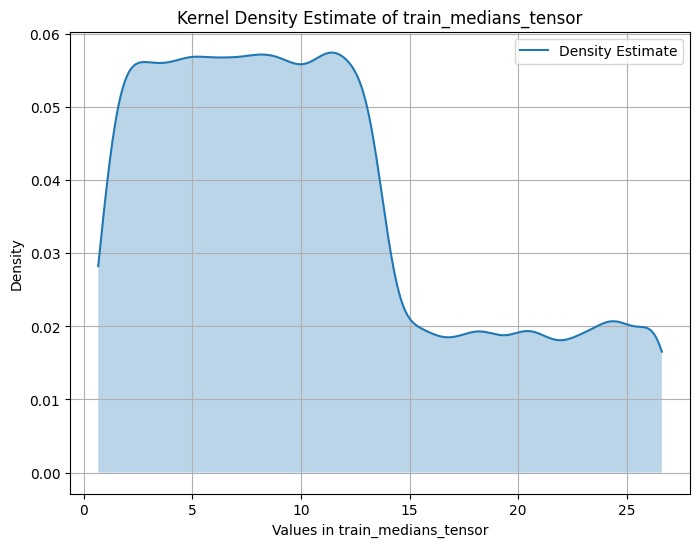

In [44]:
# Since the data is imbalanced, we weigh the data points based on their density in target values

import torch
import numpy as np
from scipy.stats import gaussian_kde




# Step 1: Estimate density of train_medians_tensor using KDE
# Convert to numpy for density estimation
train_medians_np = train_medians_tensor.numpy()

# Apply KDE to estimate density over the train_medians_tensor values
kde = gaussian_kde(train_medians_np)

# Step 2: Generate a range of values to evaluate the density
x_range = np.linspace(train_medians_np.min(), train_medians_np.max(), 1000)

# Step 3: Evaluate the density for the range of values
density_values = kde(x_range)

# Step 4: Plot the density
plt.figure(figsize=(8, 6))
plt.plot(x_range, density_values, label="Density Estimate")
plt.fill_between(x_range, density_values, alpha=0.3)
plt.title("Kernel Density Estimate of train_medians_tensor")
plt.xlabel("Values in train_medians_tensor")
plt.ylabel("Density")
plt.legend()
plt.grid(True)
plt.show()


densities = kde(train_medians_np)

# Step 2: Assign weights as inverse of density (1/density)
train_weights = torch.tensor(1.0 / densities, dtype=torch.float32, device=train_medians_tensor.device)

# Normalize the weights to avoid too large values (optional but recommended)
train_weights /= train_weights.mean()




In [45]:


from torch.utils.data import DataLoader, TensorDataset

# # Assuming train_times_tensor, train_medians_tensor, train_values_tensor, train_weights are tensors of same size
# train_dataset = TensorDataset(train_times_tensor, train_medians_tensor, train_values_tensor, train_weights)
# train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# # Create a DataLoader for the validation data as well, if necessary
# val_dataset = TensorDataset(val_times_tensor, val_medians_tensor, val_values_tensor)
# val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# # Preload entire datasets onto the GPU
# train_data_on_device = [(times.to(device), medians.to(device), values.to(device), weights.to(device)) for times, medians, values, weights in train_loader.dataset]
# val_data_on_device = [(times.to(device), medians.to(device), values.to(device)) for times, medians, values in val_loader.dataset]

# Preload entire datasets onto the GPU by accessing the tensors directly from the dataset
train_times_tensor, train_medians_tensor, train_values_tensor, train_weights = train_times_tensor.to(device), train_medians_tensor.to(device), train_values_tensor.to(device), train_weights.to(device)
val_times_tensor, val_medians_tensor, val_values_tensor = val_times_tensor.to(device), val_medians_tensor.to(device), val_values_tensor.to(device)

# Optionally, create tuples of the data if you need to pack them in a similar structure
train_data_on_device = (train_times_tensor, train_medians_tensor, train_values_tensor, train_weights)
val_data_on_device = (val_times_tensor, val_medians_tensor, val_values_tensor)
print(len(train_data_on_device[0]))
# Train num_models models and choose the best one based on validation loss
best_overall_loss = float('inf')
best_overall_model = None


64144


In [47]:
num_models = 1000



for model_index in range(num_models):
    # Initialize model with normalization
    model = S_Curve_net()
    model.to(device)
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Training loop with early stopping
    best_loss = float('inf')
    patience_counter = 0
    best_model = None

    n_epochs = 1000000
    batch_size = 10000
    patience = 3000
    for epoch in range(n_epochs):
        model.train()
        running_train_loss = 0.0

        num_batches = train_times_tensor.size(0) // batch_size

        # Iterate over the preloaded training data in batches
        for i in range(num_batches):
            # Extract batches manually by slicing the tensors
            batch_times = train_times_tensor[i * batch_size:(i + 1) * batch_size]
            batch_medians = train_medians_tensor[i * batch_size:(i + 1) * batch_size]
            batch_values = train_values_tensor[i * batch_size:(i + 1) * batch_size]
            batch_weights = train_weights[i * batch_size:(i + 1) * batch_size]
            
            optimizer.zero_grad()
            # Forward pass
            pred = model(batch_times, batch_medians)
            train_loss = criterion(pred, batch_values)

            # Apply the inverse density weights to the training loss
            weighted_train_loss = (train_loss * batch_weights).mean()

            # Backward pass and optimization
            
            weighted_train_loss.backward()
            optimizer.step()

            # Accumulate the loss for tracking
            running_train_loss += weighted_train_loss.item()

        # Calculate the average loss over the entire dataset
        # avg_train_loss = running_train_loss / len(train_data_on_device)
        avg_train_loss = running_train_loss / num_batches


        if torch.tensor(avg_train_loss).isnan():
            print("NaN loss encountered. Stopping training.")
            break

        if (epoch > 10000 and avg_train_loss > 5) or (epoch > 2000 and avg_train_loss > 20):
            print("Not good enough loss reached in reasonable time. Stopping training.")
            break
        if avg_train_loss < 1:
            # Set learning rate to 0.0001
            optimizer = optim.Adam(model.parameters(), lr=0.0001)
        if avg_train_loss < 0.5:
            # Set learning rate to 0.00001
            optimizer = optim.Adam(model.parameters(), lr=0.00001)


        if epoch % 1000 == 0:
            print(f"Epoch {epoch+1}, Training Loss: {avg_train_loss}")

        # Early stopping logic
        if avg_train_loss < best_loss:
            best_model = model
            best_loss = avg_train_loss
            patience_counter = 0
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print("Early stopping triggered.")
            break

    if best_loss < best_overall_loss:
        best_overall_loss = best_loss
        best_overall_model = best_model


NaN loss encountered. Stopping training.
NaN loss encountered. Stopping training.
Epoch 1, Training Loss: 27.39511998494466
Epoch 1001, Training Loss: 18.58353090286255
Epoch 2001, Training Loss: 18.58138306935628
Epoch 3001, Training Loss: 18.580500602722168
Epoch 4001, Training Loss: 18.579904556274414
Epoch 5001, Training Loss: 18.57932980855306
Epoch 6001, Training Loss: 18.577457110087078
Epoch 7001, Training Loss: 18.573398272196453
Epoch 8001, Training Loss: 18.571709473927815
Epoch 9001, Training Loss: 18.57113854090373
Epoch 10001, Training Loss: 18.570812066396076
Not good enough loss reached in reasonable time. Stopping training.
NaN loss encountered. Stopping training.
Epoch 1, Training Loss: 31.814338366190594
Epoch 1001, Training Loss: 18.571031093597412
Epoch 2001, Training Loss: 18.56868823369344
Epoch 3001, Training Loss: 18.580784797668457
Epoch 4001, Training Loss: 18.580366611480713
Epoch 5001, Training Loss: 18.564330101013184
Epoch 6001, Training Loss: 18.56394592

KeyboardInterrupt: 

In [48]:
if not os.path.exists("models"):
    os.makedirs("models")
torch.save(best_overall_model, f"models/val_loss={best_overall_loss}.pth")

Plotting results for x=0.525y=0.0z=0.0secs=4.0_reverse.csv


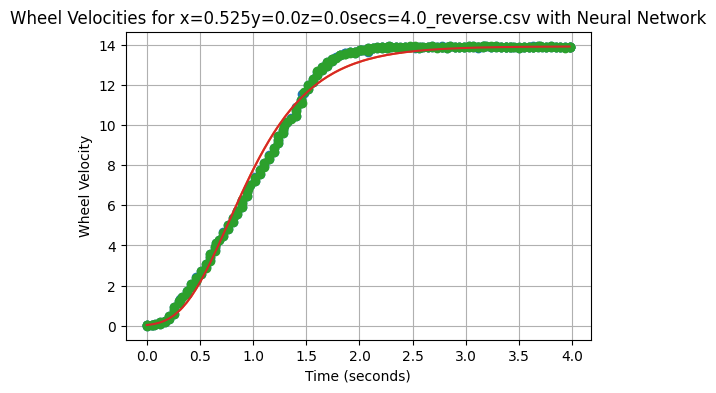

Plotting results for x=0.975y=0.0z=0.0secs=4.0.csv


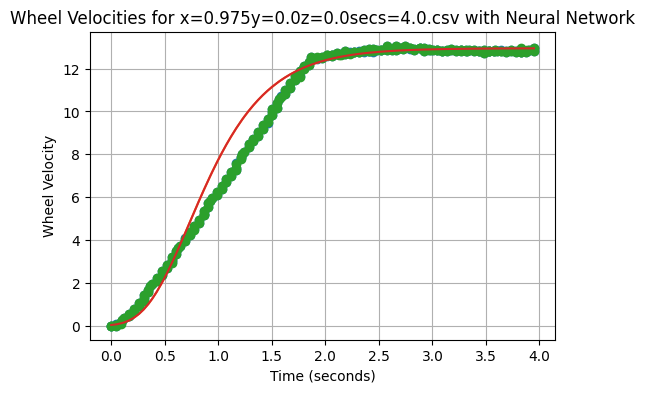

Plotting results for x=0.4y=0.0z=0.0secs=4.0_reverse.csv


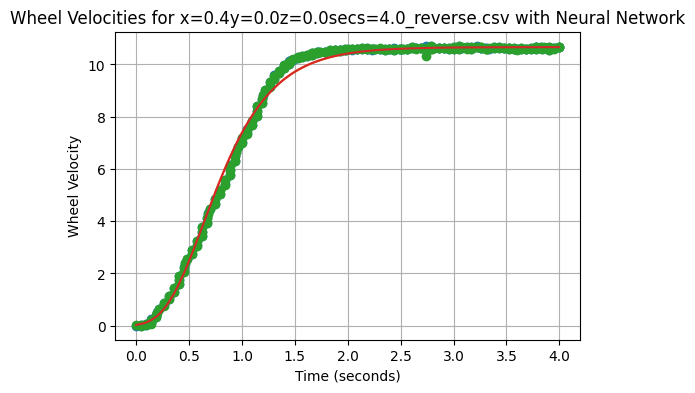

Plotting results for x=0.925y=0.0z=0.0secs=4.0_reverse.csv


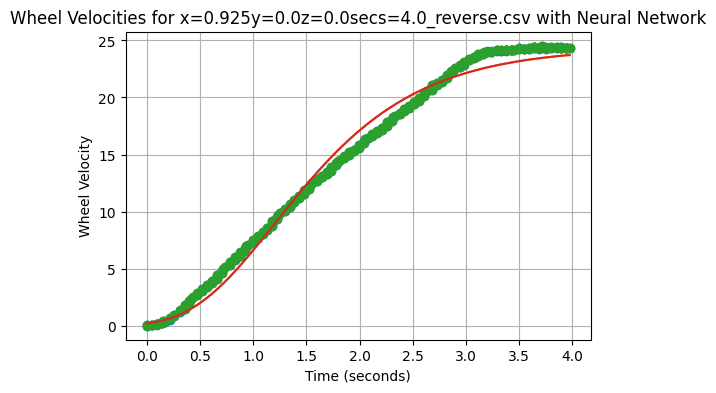

Plotting results for x=0.9y=0.0z=0.0secs=4.0.csv


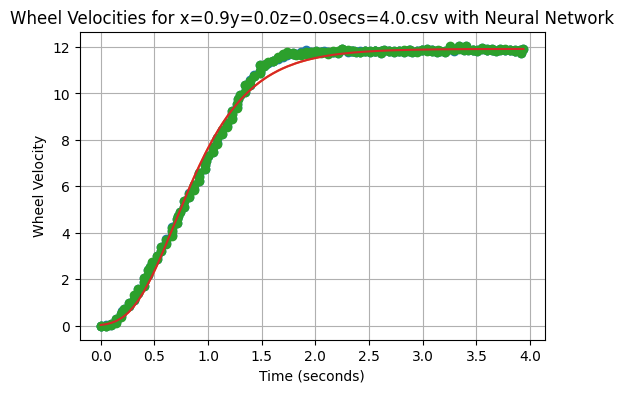

Plotting results for x=0.05y=0.0z=0.0secs=4.0.csv


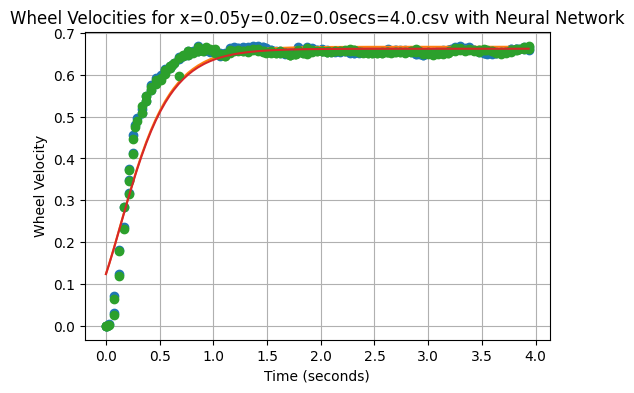

Plotting results for x=0.25y=0.0z=0.0secs=4.0_reverse.csv


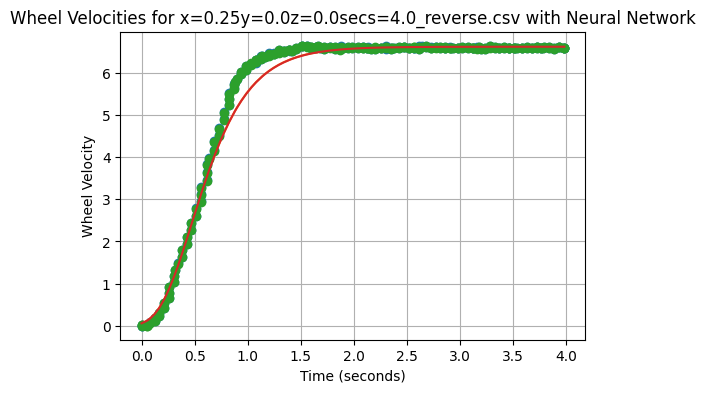

Plotting results for x=1.025y=0.0z=0.0secs=4.0_reverse.csv


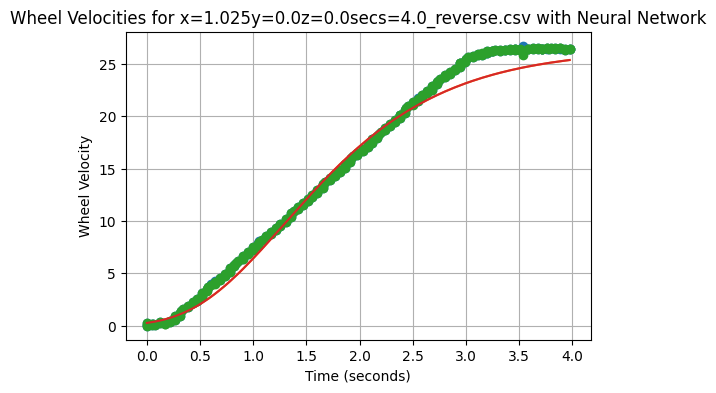

Plotting results for x=1.025y=0.0z=0.0secs=4.0.csv


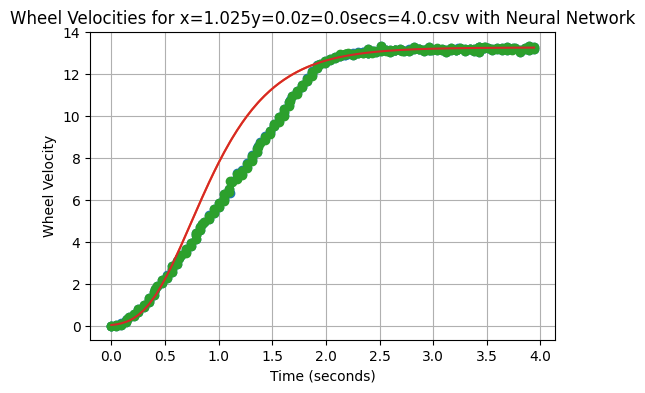

Plotting results for x=0.95y=0.0z=0.0secs=4.0.csv


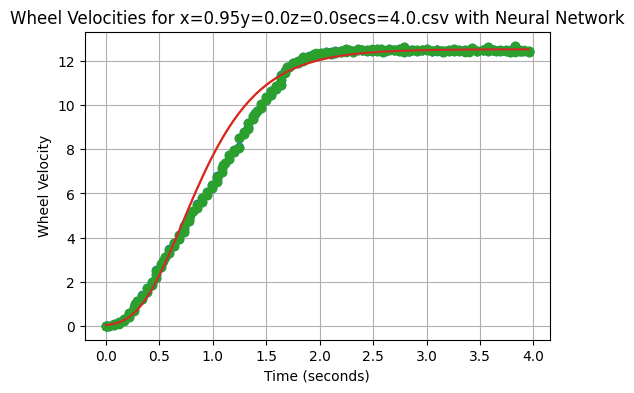

Plotting results for x=0.65y=0.0z=0.0secs=4.0.csv


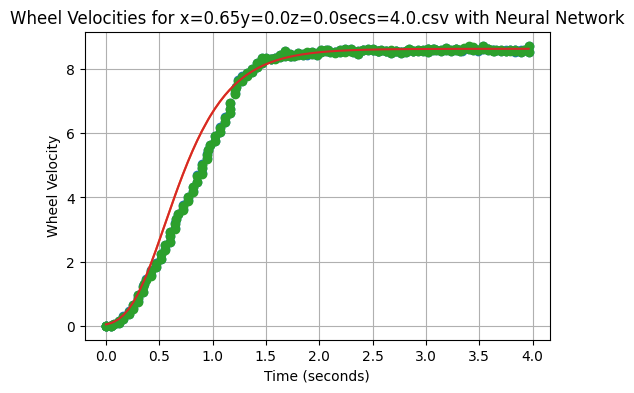

Plotting results for x=0.275y=0.0z=0.0secs=4.0.csv


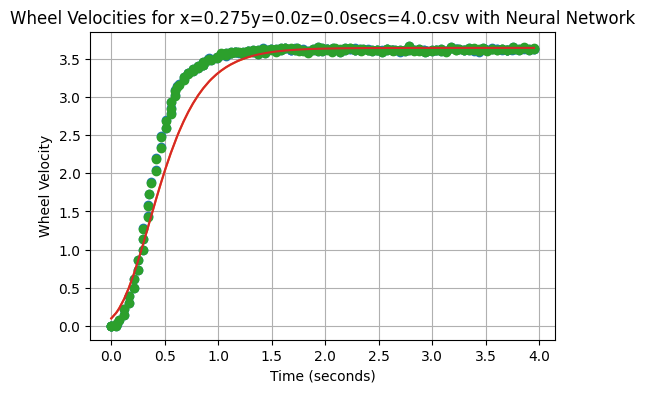

Plotting results for x=0.225y=0.0z=0.0secs=4.0.csv


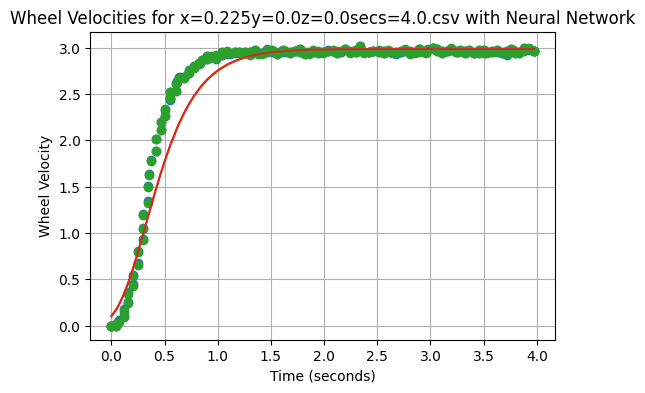

Plotting results for x=0.825y=0.0z=0.0secs=4.0_reverse.csv


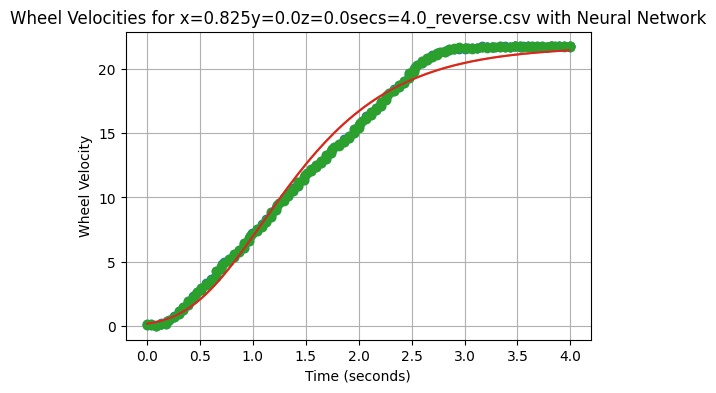

Plotting results for x=0.175y=0.0z=0.0secs=4.0.csv


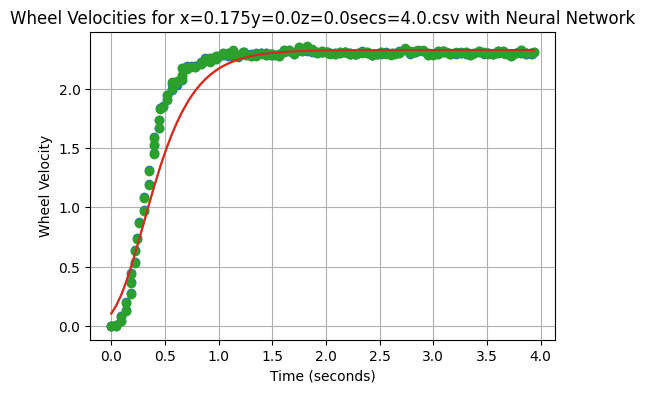

Plotting results for x=0.425y=0.0z=0.0secs=4.0.csv


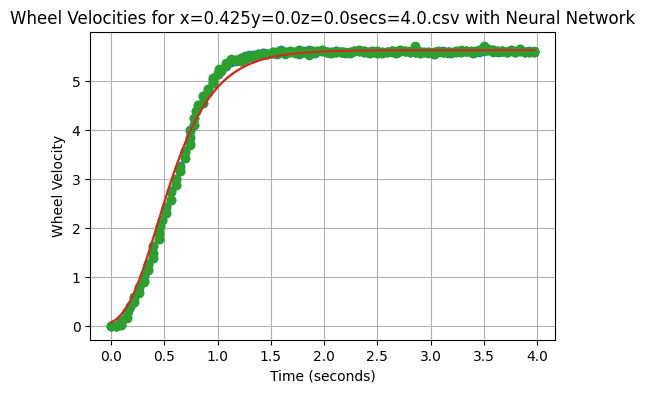

Plotting results for x=0.175y=0.0z=0.0secs=4.0_reverse.csv


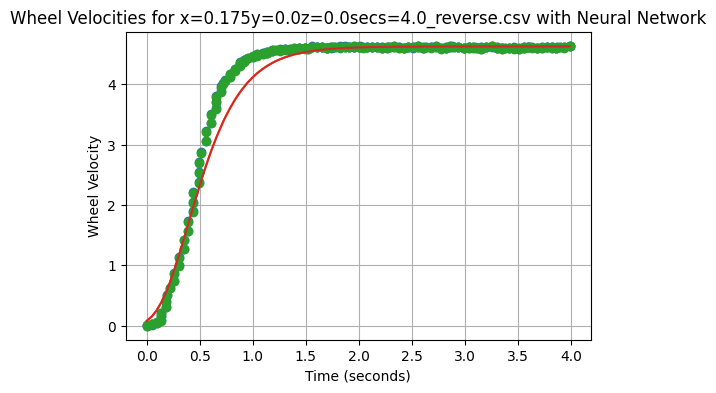

Plotting results for x=0.75y=0.0z=0.0secs=4.0.csv


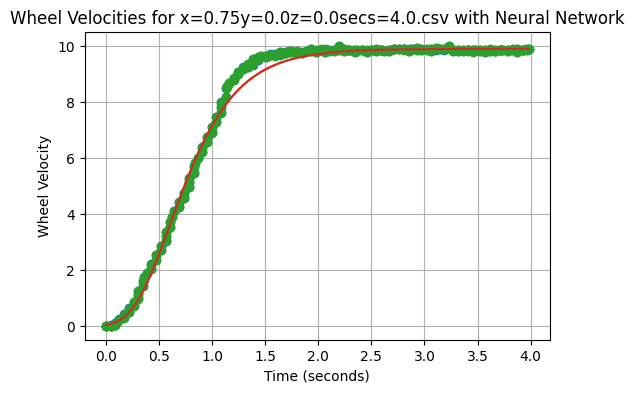

Plotting results for x=0.2y=0.0z=0.0secs=4.0.csv


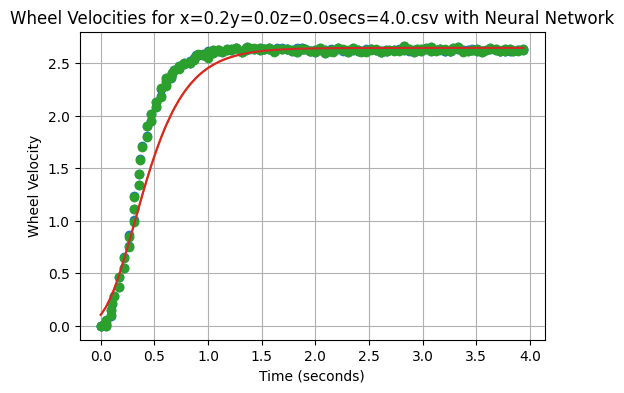

Plotting results for x=0.15y=0.0z=0.0secs=4.0_reverse.csv


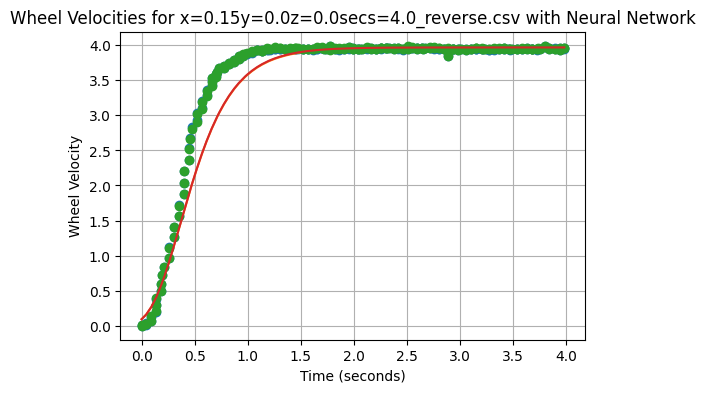

Plotting results for x=0.475y=0.0z=0.0secs=4.0_reverse.csv


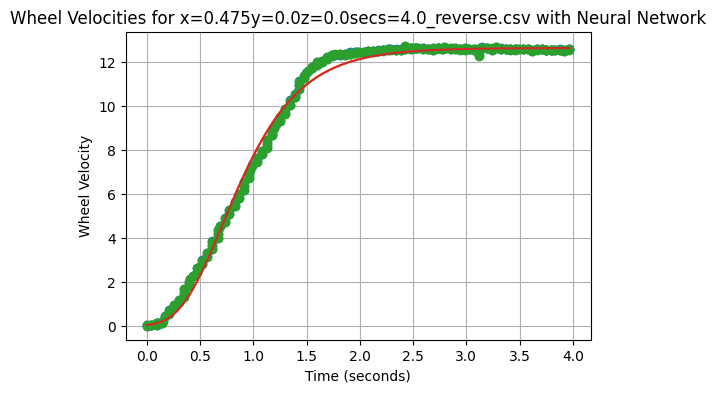

Plotting results for x=0.675y=0.0z=0.0secs=4.0_reverse.csv


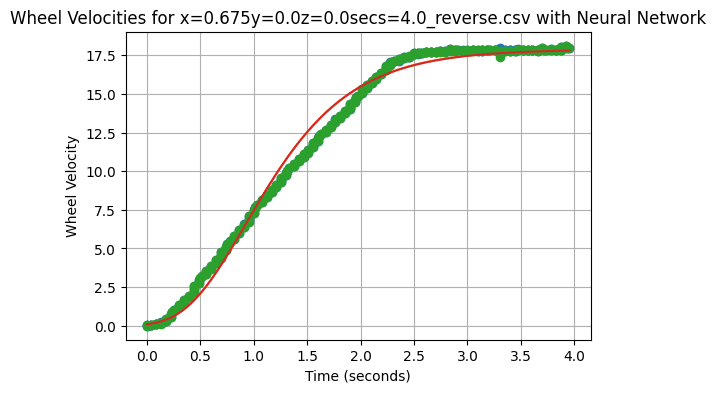

Plotting results for x=0.625y=0.0z=0.0secs=4.0_reverse.csv


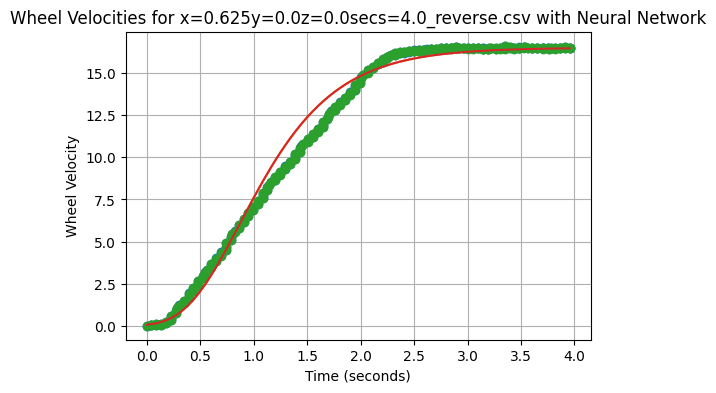

Plotting results for x=0.8y=0.0z=0.0secs=4.0.csv


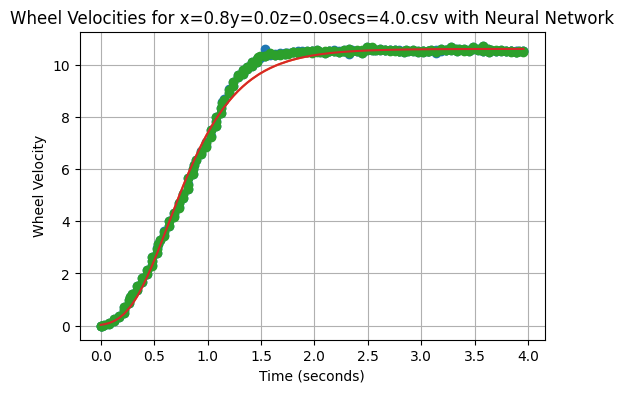

All data have been processed, plotted, and evaluated with the neural network.


In [49]:
model = torch.load(f"models/val_loss={best_overall_loss}.pth")

# move model to device
model.to("cpu")

# Plotting results for the best model
for file_path in validation_files:
    print(f"Plotting results for {os.path.basename(file_path)}")
    data = pd.read_csv(file_path)
    time = data['Time']
    wheels = data.columns[1:]
    
    plt.figure(figsize=(6, 4))
    
    for wheel in wheels[:2]:
        values = process_velocities(data[wheel])
        
        adjusted_time = time - time.iloc[0]
        adjusted_time = adjusted_time[adjusted_time < max_time]
        values_array = values[: len(adjusted_time)]

        sorted_values = values_array.sort_values().reset_index(drop=True)
        index_95th = int(len(sorted_values) * 0.95)
        lower_index = max(0, index_95th - 5)
        upper_index = min(len(sorted_values) - 1, index_95th + 5)
        neighbors = sorted_values[lower_index:upper_index + 1]
        target_velocity = neighbors.mean()
        
        plt.plot(adjusted_time, values_array, 'o', label=f"{wheel} data")
        
        with torch.no_grad():
            fitted_curve = model(torch.tensor(adjusted_time.values, dtype=torch.float32), torch.tensor([target_velocity] * len(adjusted_time), dtype=torch.float32))
        
        plt.plot(adjusted_time, fitted_curve, '-', label=f"{wheel} fitted sigmoid")
    
    plt.xlabel("Time (seconds)")
    plt.ylabel("Wheel Velocity")
    plt.title(f"Wheel Velocities for {os.path.basename(file_path)} with Neural Network")
    # plt.legend()
    plt.grid(True)
    plt.show()

print("All data have been processed, plotted, and evaluated with the neural network.")

Processing x=0.525y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.975y=0.0z=0.0secs=4.0.csv
Processing x=0.4y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.925y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.9y=0.0z=0.0secs=4.0.csv
Processing x=0.05y=0.0z=0.0secs=4.0.csv
Processing x=0.25y=0.0z=0.0secs=4.0_reverse.csv
Processing x=1.025y=0.0z=0.0secs=4.0_reverse.csv
Processing x=1.025y=0.0z=0.0secs=4.0.csv
Processing x=0.95y=0.0z=0.0secs=4.0.csv
Processing x=0.65y=0.0z=0.0secs=4.0.csv
Processing x=0.275y=0.0z=0.0secs=4.0.csv
Processing x=0.225y=0.0z=0.0secs=4.0.csv
Processing x=0.825y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.175y=0.0z=0.0secs=4.0.csv
Processing x=0.425y=0.0z=0.0secs=4.0.csv
Processing x=0.175y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.75y=0.0z=0.0secs=4.0.csv
Processing x=0.2y=0.0z=0.0secs=4.0.csv
Processing x=0.15y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.475y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.675y=0.0z=0.0secs=4.0_reverse.csv
Processing x=0.625y=0.0z=0.0se

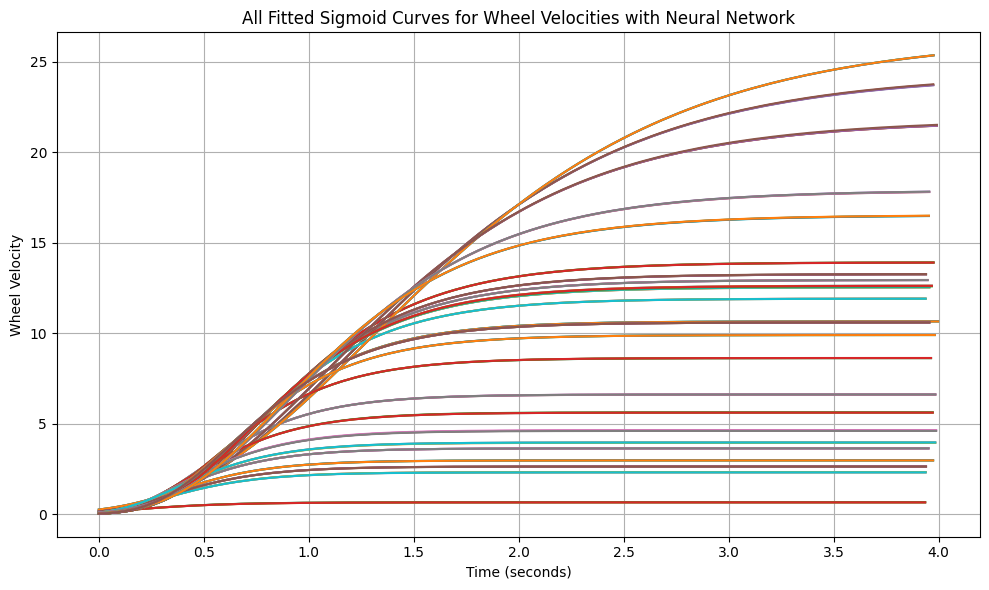

All fitted curves have been plotted together.


In [50]:

# Initialize figure for all fitted plots
plt.figure(figsize=(10, 6))

# Loop over each file and plot fitted curves together
for file_path in validation_files:
    print(f"Processing {os.path.basename(file_path)}")
    data = pd.read_csv(file_path)
    time = data['Time']
    wheels = data.columns[1:]
    
    for wheel in wheels:
        values = process_velocities(data[wheel])
        
        adjusted_time = time - time.iloc[0]
        adjusted_time = adjusted_time[adjusted_time < max_time]
        values_array = values[: len(adjusted_time)]

        sorted_values = values_array.sort_values().reset_index(drop=True)
        index_95th = int(len(sorted_values) * 0.95)
        lower_index = max(0, index_95th - 5)
        upper_index = min(len(sorted_values) - 1, index_95th + 5)
        neighbors = sorted_values[lower_index:upper_index + 1]
        target_velocity = neighbors.mean()
        
        # Calculate fitted sigmoid curve
        with torch.no_grad():
            fitted_curve = model(torch.tensor(adjusted_time.values, dtype=torch.float32), torch.tensor([target_velocity] * len(adjusted_time), dtype=torch.float32))
        # Plotting all fitted curves together
        plt.plot(adjusted_time, fitted_curve, '-', label=f"{wheel} fitted sigmoid ({os.path.basename(file_path)})")

# Labeling the plot
plt.xlabel("Time (seconds)")
plt.ylabel("Wheel Velocity")
plt.title("All Fitted Sigmoid Curves for Wheel Velocities with Neural Network")
# plt.legend(loc='upper right', fontsize='small', bbox_to_anchor=(1.2, 1.0))
plt.grid(True)
plt.tight_layout()
plt.show()

print("All fitted curves have been plotted together.")

In [51]:

import json
import base64

# Save model parameters to a dictionary
model_params = {
    'fc1_weight': model.fc1.weight.detach().numpy().tolist(),
    'fc1_bias': model.fc1.bias.detach().numpy().tolist(),
    'fc2_weight': model.fc2.weight.detach().numpy().tolist(),
    'fc2_bias': model.fc2.bias.detach().numpy().tolist(),
    'fc3_weight': model.fc3.weight.detach().numpy().tolist(),
    'fc3_bias': model.fc3.bias.detach().numpy().tolist()
}

# Serialize model parameters to a string
model_params_str = base64.b64encode(json.dumps(model_params).encode()).decode()

print("Model parameters saved as string:")
print(model_params_str)

Model parameters saved as string:
eyJmYzFfd2VpZ2h0IjogW1swLjQxODQ4ODM1MzQ5MDgyOTQ3XSwgWzAuOTM0Nzg3MzkyNjE2MjcyXSwgWzAuNDczMjM2MTQzNTg5MDE5OF0sIFsyLjM3Mjc3NzQ2MjAwNTYxNTJdLCBbLTEuNTk3NzQ4MTYwMzYyMjQzN10sIFsxLjIxNTI5Mzc2NTA2ODA1NDJdLCBbMS42ODgyODQ1MTYzMzQ1MzM3XSwgWy0wLjkzNDQxMjY1ODIxNDU2OTFdLCBbLTIuMDk3NzM4OTgxMjQ2OTQ4Ml0sIFstMS40NjMxMDQwMDk2MjgyOTZdLCBbMC43OTYyNzEzODM3NjIzNTk2XSwgWy0xLjk0MDUyNjM2NjIzMzgyNTddLCBbLTAuNjU3NzI0MTQyMDc0NTg1XSwgWy0wLjM1NDEwODEyNDk3MTM4OTc3XSwgWzIuMjU1NTAxMDMxODc1NjEwNF0sIFstMS4zNzYxMDQ3MTI0ODYyNjddLCBbMS4zMjg0MjU2NDU4MjgyNDddLCBbLTIuMzk5ODE3OTQzNTcyOTk4XSwgWzAuMTA0MTU2ODIxOTY2MTcxMjZdLCBbLTAuOTYzNzc4OTcyNjI1NzMyNF0sIFsxLjM4MDUwMDU1NTAzODQ1MjFdLCBbLTAuNzA1MDk1NjQ4NzY1NTY0XSwgWy0wLjQ3MTU1NjI3NjA4Mjk5MjU1XSwgWy0xLjM2MjgwNjMyMDE5MDQyOTddLCBbMC4zMzQ3NjA0ODcwNzk2MjAzNl0sIFswLjk2ODAwMjM3ODk0MDU4MjNdLCBbMS42OTA3MzYxNzQ1ODM0MzVdLCBbMC4wMzE5MDY3NzI0MDQ5MDkxMzRdLCBbMS4zNjQ2ODE2MDE1MjQzNTNdLCBbLTAuMDQzMzgzMzExNDgwMjgzNzRdLCBbLTEuMzkzMjE4NjM2NTEyNzU2M10sIFswLjQ1NzYzMjU3MT

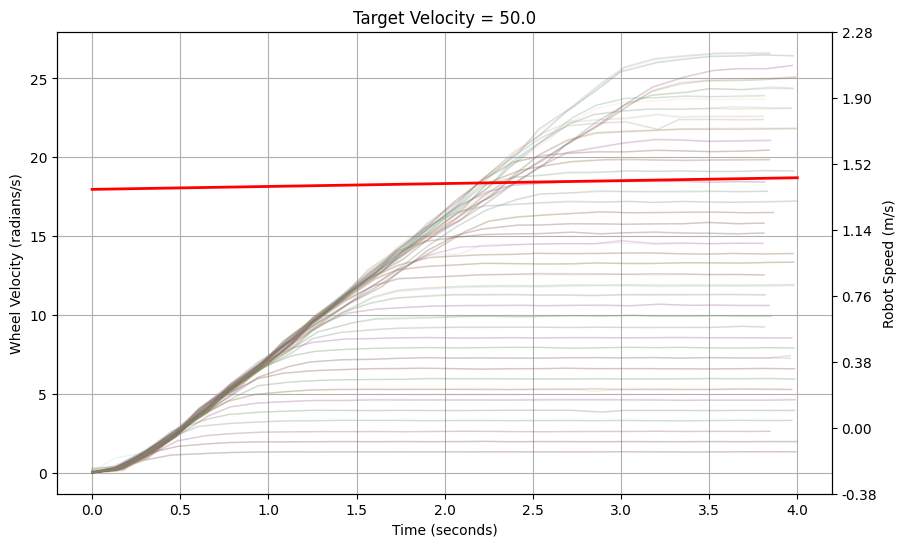

In [52]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import pandas as pd  # Ensure pandas is imported
import os

# Generate time values
time_values = np.linspace(0, 4, 100)  # 100 time points between 0 and 4 seconds
wheel_radius = 0.076  # Wheel radius in meters

# Initialize figure
fig, ax = plt.subplots(figsize=(10, 6))

odd = False
# Plot the background (all fitted sigmoid curves)
for file_path in validation_files + training_files:
    # # skip ever second file
    # if odd:
    #     odd = False
    #     continue
    # else:
    #     odd = True
    if "reverse" in file_path:

        data = pd.read_csv(file_path)
        time = data['Time']
        wheels = data.columns[1:]

        for wheel in wheels:
            values = process_velocities(data[wheel])

            adjusted_time = time - time.iloc[0]
            adjusted_time = adjusted_time[adjusted_time < max_time]
            values_array = values[: len(adjusted_time)]

            sorted_values = values_array.sort_values().reset_index(drop=True)
            index_95th = int(len(sorted_values) * 0.95)
            lower_index = max(0, index_95th - 5)
            upper_index = min(len(sorted_values) - 1, index_95th + 5)
            neighbors = sorted_values[lower_index:upper_index + 1]
            target_velocity = neighbors.mean()

            # Calculate fitted sigmoid curve
            with torch.no_grad():
                fitted_curve = model(torch.tensor(adjusted_time, dtype=torch.float32), torch.tensor([target_velocity] * len(adjusted_time), dtype=torch.float32)).detach().numpy()

            # Plot all fitted curves in the background
            ax.plot(adjusted_time[::8], values_array[::8], '-', label=f"{wheel} fitted sigmoid ({os.path.basename(file_path)})", alpha=0.1, linewidth=1)

# Labeling the plot
ax.set_xlabel("Time (seconds)")
ax.set_ylabel("Wheel Velocity (radians/s)")
ax.set_title("All Fitted Sigmoid Curves with Animation Overlay")
ax.grid(True)

# Create a secondary y-axis for robot speed
ax2 = ax.twinx()  # Create a twin axis sharing the x-axis
ax2.set_ylabel('Robot Speed (m/s)')

# Set the tick labels on the right-hand side for robot speed
# Robot speed is calculated as wheel velocity * radius
wheel_ticks = ax.get_yticks()  # Get current wheel velocity ticks
robot_speed_ticks = wheel_ticks * wheel_radius  # Convert to robot speed
ax2.set_yticks(wheel_ticks)  # Use the same tick positions
ax2.set_yticklabels([f'{tick:.2f}' for tick in robot_speed_ticks])  # Set the tick labels

# Now, initialize the animation plot
line, = ax.plot([], [], lw=2, color='red')  # Animated curve will be red

# Initialize the plot function for animation
def init():
    line.set_data([], [])
    return line,

# Update function for animation
def update(frame):
    global target_velocity
    
    # Set the current target_velocity (time t = target_velocity)
    target_velocity = frame

    fitted_curve = model(torch.tensor(time_values, dtype=torch.float32), torch.tensor([target_velocity] * len(time_values), dtype=torch.float32)).detach().numpy()
   
    # Update the line plot with new data for the animated curve
    line.set_data(time_values, fitted_curve)
    ax.set_title(f"Target Velocity = {target_velocity:.1f}")
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=np.linspace(0., 50, 100),
                    init_func=init, blit=True, repeat=False)

# Display the animation inline in the Jupyter Notebook
HTML(ani.to_jshtml())


In [53]:
import json
import base64
import numpy as np

# Load model parameters from the string
# Function to add padding if necessary
def add_padding(base64_string):
    missing_padding = len(base64_string) % 4
    if missing_padding:
        base64_string += '=' * (4 - missing_padding)
    return base64_string

# Add padding if necessary
model_params_str_padded = add_padding(model_params_str)

# Extract weights and biases from the dictionary
fc1_weight = np.array(model_params['fc1_weight'])
fc1_bias = np.array(model_params['fc1_bias'])

fc2_weight = np.array(model_params['fc2_weight'])
fc2_bias = np.array(model_params['fc2_bias'])

fc3_weight = np.array(model_params['fc3_weight'])
fc3_bias = np.array(model_params['fc3_bias'])

# ReLU function definition
def relu_np(x):
    return np.maximum(0, x)

# Gompertz function definition
def gompertz_np(x, L=1, k=6, x0=0.1):
    return L * np.exp(-np.exp(-k * (x - x0)))

# Forward pass function using numpy
def forward_pass(x, K):
    # Ensure x and K are 2D arrays for matrix operations
    x = np.reshape(x, (-1, 1))
    K = np.reshape(K, (-1, 1))
    
    # Forward pass through the first layer (fc1)
    out = np.dot(K, fc1_weight.T) + fc1_bias
    out = relu_np(out)
    
    # Forward pass through the second layer (fc2)
    out = np.dot(out, fc2_weight.T) + fc2_bias
    out = relu_np(out)
    
    # Forward pass through the third layer (fc3)
    out = np.dot(out, fc3_weight.T) + fc3_bias
    
    # Extract k and x0 from the output (assuming the last layer has two outputs)
    k = out[:, 0]
    x0 = out[:, 1]
    
    # Calculate the Gompertz function using the output values
    predictions = gompertz_np(x=x, L=K, k=k, x0=x0)
    
    return predictions

# Example usage:
# Let's assume we have numpy arrays for `x` (times) and `K` (medians) from the saved dataset
x_numpy = np.array([0.5])  # Example input time
K_numpy = np.array([1.0])  # Example input K (median)

# Make a prediction
predictions = forward_pass(x_numpy, K_numpy)
print("Predictions:", predictions)


Predictions: [[0.77518957]]
